In [38]:
import stlearn as st
import os
import pandas as pd
from pathlib import Path
import scanpy as sc
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from PIL import Image 
from typing import Optional, Union
from anndata import AnnData
from scipy import ndimage as ndi
import seaborn as sns

In [3]:
print(st.__version__)
print(pd.__version__)

0.2.4
1.0.5


###  load visium data and split two sections

In [4]:
# data = st.read.file_10x_h5("filtered_feature_bc_matrix.h5")
# data.var_names_make_unique()
path = '/QRISdata/Q1851/Minh/Spatial_transcriptomic/C1_refined/'
data = st.read.file_10x_mtx(os.path.join(path, "filtered_feature_bc_matrix"))
data.var_names_make_unique()
st.add.image(adata=data, imgpath=path + "spatial/tissue_hires_image.png", library_id='whatever')

Added tissue image to the object!


In [5]:
st.add.positions(data,position_filepath =path +  "spatial/tissue_positions_list.csv",
                scale_filepath = path + "spatial/scalefactors_json.json",
                quality="high")
tissues = pd.read_csv('/QRISdata/Q1851/Minh/RNAScope/SkinSpatial/Tissue2_only.csv', sep=',', index_col = 0)
data.obs['tissue'] = tissues.Tissue2 # if your object is called "data"
data_subset = data[data.obs['tissue'] == 'Tissue2']


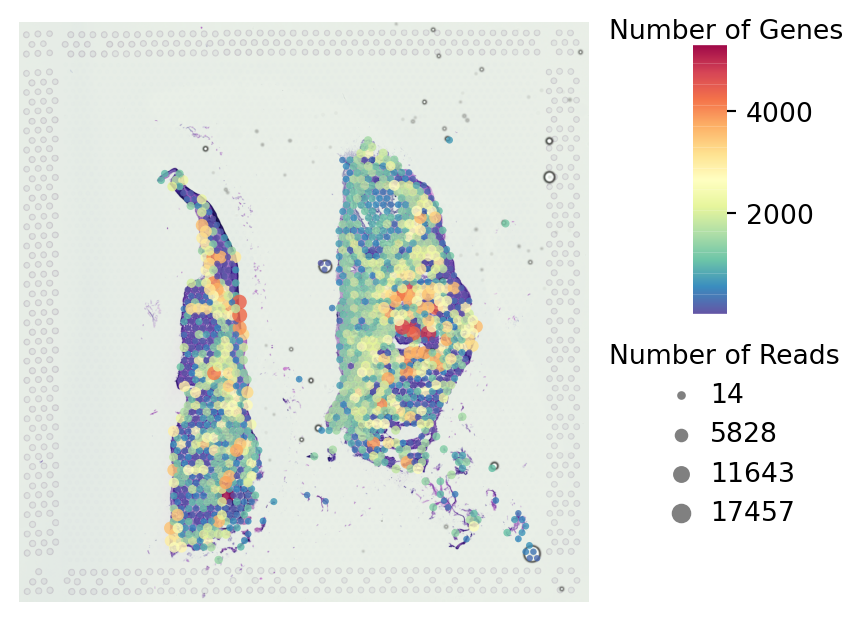

In [6]:
st.pl.QC_plot(data)

/90days/s4596423/envs/stlearn/lib/python3.7/site-packages/stlearn/plotting/gene_plot.py:147: UserWarning: We removed CD8 because they not exist in the data
  " because they not exist in the data")


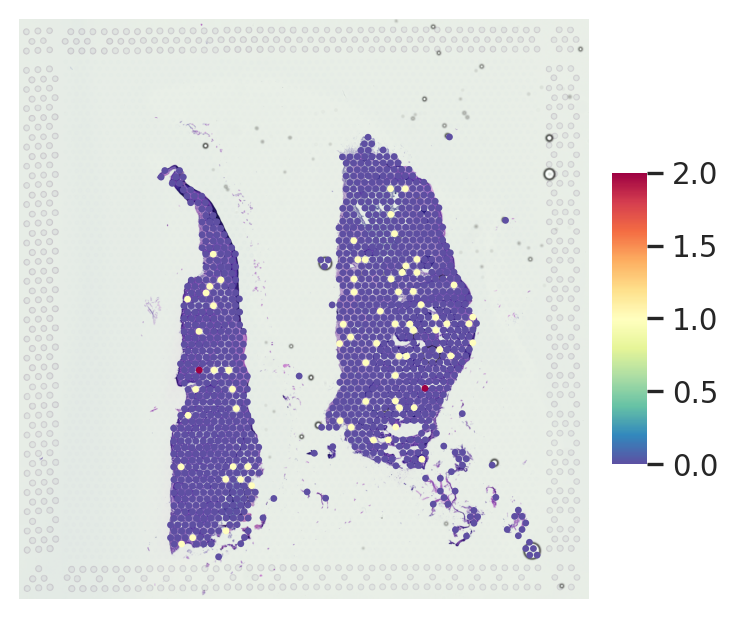

In [106]:
st.pl.gene_plot(data, genes=['CD4', 'CD8'])

checkpoint  {'xlim': [1043.237568, 1601.828616], 'ylim': [1596.500684, 351.46194]}


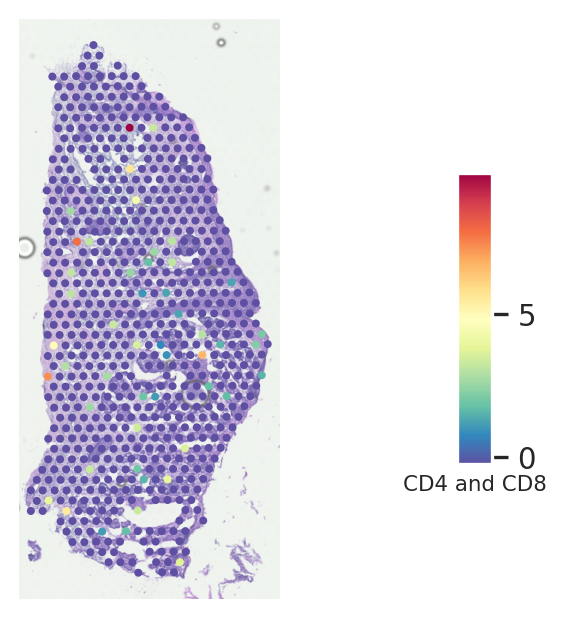

In [119]:
gene_plot(data_subset, genes=['CD4', 'CD8'], tissue_alpha=0.66, spot_size=9,
          title='CD4 and CD8', output='./', name='0708_CD4_CD8')

In [7]:
ST_LABEL = 'predict_assay_subset_rmfibroblast_2.csv'

label_df = pd.read_csv(ST_LABEL, index_col=0)
# label_df_ = label_df.T[data.obs_names]
label_df.head()

,AAACAAGTATCTCCCA-1,AAACAGTGTTCCTGGG-1,AAACATTTCCCGGATT-1,AAACCGTTCGTCCAGG-1,AAACGAGACGGTTGAT-1,AAAGTGTGATTTATCT-1,AAAGTTGACTCCCGTA-1,AAATAGCTTAGACTTT-1,AAATAGGGTGCTATTG-1,AAATCTAGCCCTGCTA-1,...,TTGGCTCGCATGAGAC-1,TTGGGCGGCGGTTGCC-1,TTGGTCACACTCGTAA-1,TTGTAAGGACCTAAGT-1,TTGTAAGGCCAGTTGG-1,TTGTGGTGGTACTAAG-1,TTGTTGTGTGTCAAGA-1,TTGTTTCACATCCAGG-1,TTGTTTCATTAGTCTA-1,TTGTTTGTATTACACG-1
T cells,0.035814,0.024683,0.085743,0.145462,0.909341,0.033954,0.653707,0.197027,0.125689,0.030901,...,0.026987,0.056063,0.000000,0.204508,0.159526,0.197034,0.180417,0.032011,0.146104,0.025344
macrophages/dendritic,0.257627,0.243260,0.259431,0.090012,0.027789,0.413388,0.113038,0.020129,0.070369,0.229749,...,0.515003,0.175569,0.000000,0.197156,0.071511,0.145705,0.250402,0.310511,0.136399,0.084202
pericytes,0.342138,0.316136,0.099209,0.072327,0.016156,0.057825,0.055600,0.000603,0.453649,0.149359,...,0.196906,0.436608,0.000000,0.002315,0.126636,0.079751,0.062150,0.035798,0.076982,0.250414
epidermal stem cell,0.069735,0.051200,0.258701,0.236790,0.034395,0.070385,0.013064,0.094709,0.202278,0.206160,...,0.000000,0.090525,0.021876,0.176349,0.141562,0.226961,0.426859,0.107582,0.437857,0.045128
vascular endothelial,0.000000,0.231881,0.016428,0.154429,0.000294,0.336872,0.058039,0.056352,0.015744,0.027757,...,0.044652,0.008058,0.002455,0.031026,0.036722,0.083351,0.012532,0.371170,0.088826,0.119875


In [8]:
label_df_Transfer = label_df[data_subset.obs_names]
data_subset.obsm["label"] = label_df_Transfer.transpose().iloc[:, 0:-1]

In [9]:
data_subset

AnnData object with n_obs × n_vars = 676 × 33538 
    obs: 'imagerow', 'imagecol', 'tissue'
    var: 'gene_ids', 'feature_types'
    uns: 'spatial'
    obsm: 'label'

In [32]:
def draw_pie(dist,
             xpos,
             ypos,
             size,
             cmap,
             ax=None):
    if ax is None:
        fig, ax = plt.subplots(figsize=(20, 10))

    # for incremental pie slices
    cumsum = np.cumsum(dist)
    cumsum = cumsum / cumsum[-1]
    pie = [0] + cumsum.tolist()

    for i, (r1, r2) in enumerate(zip(pie[:-1], pie[1:])):
        angles = np.linspace(2 * np.pi * r1, 2 * np.pi * r2)
        x = [0] + np.cos(angles).tolist()
        y = [0] + np.sin(angles).tolist()

        xy = np.column_stack([x, y])

        ax.scatter([xpos], [ypos], marker=xy, s=size, c=[cmap(int(i + 1) / 19)])

    return ax


def label_plot(
        adata: AnnData,
        name: str = None,
        method: str = None,
        tissue_alpha: float = 1.0,
        cmap: str = "vega_20_scanpy",
        show_legend: bool = True,
        show_axis: bool = False,
        dpi: int = 500,
        output: str = None,
        ues_data: str = "label",
        copy: bool = False,
        x_min: Union[float, int] = None, x_max: Union[float, int] = None, add_x: Union[float, int] = None,
        y_min: Union[float, int] = None, y_max: Union[float, int] = None, add_y: Union[float, int] = None,
) -> Optional[AnnData]:
#     from stlearn.external.scanpy.plotting import palettes
    from scanpy.plotting import palettes
    if cmap == "vega_10_scanpy":
        cmap = palettes.vega_10_scanpy
    elif cmap == "vega_20_scanpy":
        cmap = palettes.vega_20_scanpy
    elif cmap == "default_102":
        cmap = palettes.default_102
    elif cmap == "default_28":
        cmap = palettes.default_28
    else:
        raise ValueError(
            "We only support vega_10_scanpy, vega_20_scanpy, default_28, default_102")

    cmaps = matplotlib.colors.LinearSegmentedColormap.from_list("", cmap)

    cmap_ = plt.cm.get_cmap(cmaps)

    labels_df = adata.obsm[ues_data]

    plt.rcParams['figure.dpi'] = dpi

    # Option for turning off showing figure
    plt.ioff()

    # Initialize matplotlib
    fig, a = plt.subplots()

    for index, row in labels_df.iterrows():
        draw_pie(row, adata.obs["imagecol"][index], adata.obs["imagerow"][index], 6.5, cmap_, ax=a)
    print('xlim:', x_min - add_x, x_max + add_x)
    print('ylim:', y_max + add_y, y_min - add_y)
    plt.xlim([x_min - add_x, x_max + add_x])
    plt.ylim([y_max + add_y, y_min - add_y])

    if show_legend:
        from matplotlib.patches import Patch
        legend_elements = [Patch(color=cmap_(int(i + 1) / 19), label=j) for i, j in enumerate(labels_df.columns.values)]
#         a.legend(handles=legend_elements, loc='lower center', bbox_to_anchor=(0.5, -0.5), prop=dict(size=7))
        a.legend(handles=legend_elements, loc='lower center', bbox_to_anchor=(0.4, -0.2), prop=dict(size=7))
    if not show_axis:
        a.axis('off')

    # Overlay the tissue image
#     data_subset.uns['spatial']['whatever']['images']['hires']
#     a.imshow(adata.uns["spatial"], alpha=tissue_alpha, zorder=-1, )
    a.imshow(data_subset.uns['spatial']['whatever']['images']['hires'], alpha=tissue_alpha, zorder=-1, )
    if name is None:
        name = method
    if output is not None:
        fig.savefig(output + "/" + name + ".pdf", dpi=dpi, bbox_inches='tight', pad_inches=0)

    plt.show()

In [33]:

def global_label_plot(adata, ues_data="label",
                     output=None, name=None, dpi=500):
    x_min, x_max = adata.obs["imagecol"].min(), adata.obs["imagecol"].max()
    y_min, y_max = adata.obs["imagerow"].min(), adata.obs["imagerow"].max()
    add_x = (x_max - x_min)//20
    add_y = (y_max - y_min)//20

    label_plot(adata, ues_data=ues_data, output=output, name=name, 
               x_min=x_min, x_max=x_max, add_x=add_x, 
               y_min=y_min, y_max=y_max, add_y=add_y, dpi=dpi)

In [34]:
def coloc_lot_filter(adata, cell_tpyes, threshold_filter_low=0.0, 
                     threshold_filter_high=1.0, threshold_select=0.0,
                     output=None, name=None):
    x_min, x_max = adata.obs["imagecol"].min(), adata.obs["imagecol"].max()
    y_min, y_max = adata.obs["imagerow"].min(), adata.obs["imagerow"].max()
    add_x = (x_max - x_min)//20
    add_y = (y_max - y_min)//20
    df = adata.obsm["label"]
    df_coloc = df.loc[:, cell_tpyes]
    for i in cell_tpyes:
        df_coloc = df_coloc.query('`{0}` > @threshold_filter_low & `{0}` < @threshold_filter_high'.format(i))
    
    df_coloc = df_coloc[df_coloc.sum(axis=1) > threshold_select]
    df_coloc = df_coloc.div(df_coloc.sum(axis=1), axis=0)
    data_coloc = adata[df_coloc.index,:]
    data_coloc.obsm["coloc"] = df_coloc
    label_plot(data_coloc, ues_data="coloc", output=output, name=name, 
               x_min=x_min, x_max=x_max, add_x=add_x, 
               y_min=y_min, y_max=y_max, add_y=add_y)

xlim: 1043.237568 1601.828616
ylim: 1596.500684 351.46194


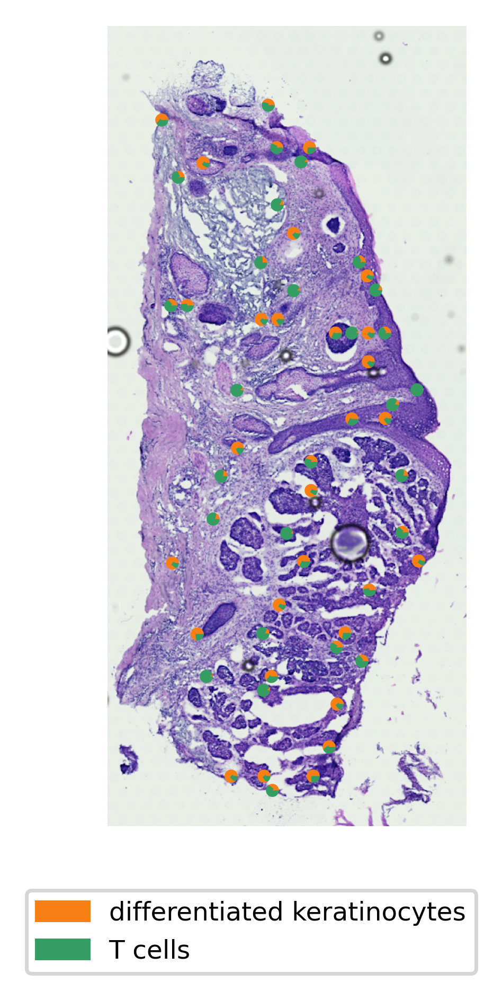

In [13]:
coloc_lot_filter(data_subset, ["differentiated keratinocytes", "T cells"], 
                 threshold_filter_low=0.05, threshold_filter_high=0.9, threshold_select=0.5,
                 output='/QRISdata/Q1851/Minh/RNAScope/SkinSpatial',name='0707_scater_plot_keratinocytes_vs_Tcells')

In [ ]:
coloc_lot_filter(data_subset, [], 
                 threshold_filter_low=0.05, threshold_filter_high=0.9, threshold_select=0.5,
                 output='/QRISdata/Q1851/Minh/RNAScope/SkinSpatial',name='0707_he_only')

xlim: 1043.237568 1601.828616
ylim: 1596.500684 351.46194


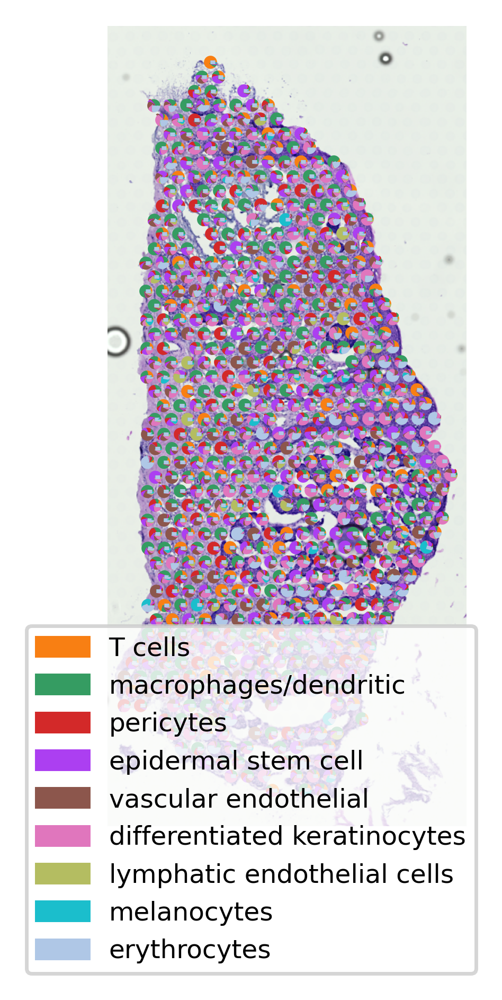

In [35]:
global_label_plot(data_subset, output='/QRISdata/Q1851/Minh/RNAScope/SkinSpatial',
                  name='0708_scater_plot_label_transfer', dpi=500)

TypeError: unsupported operand type(s) for +: 'float' and 'str'

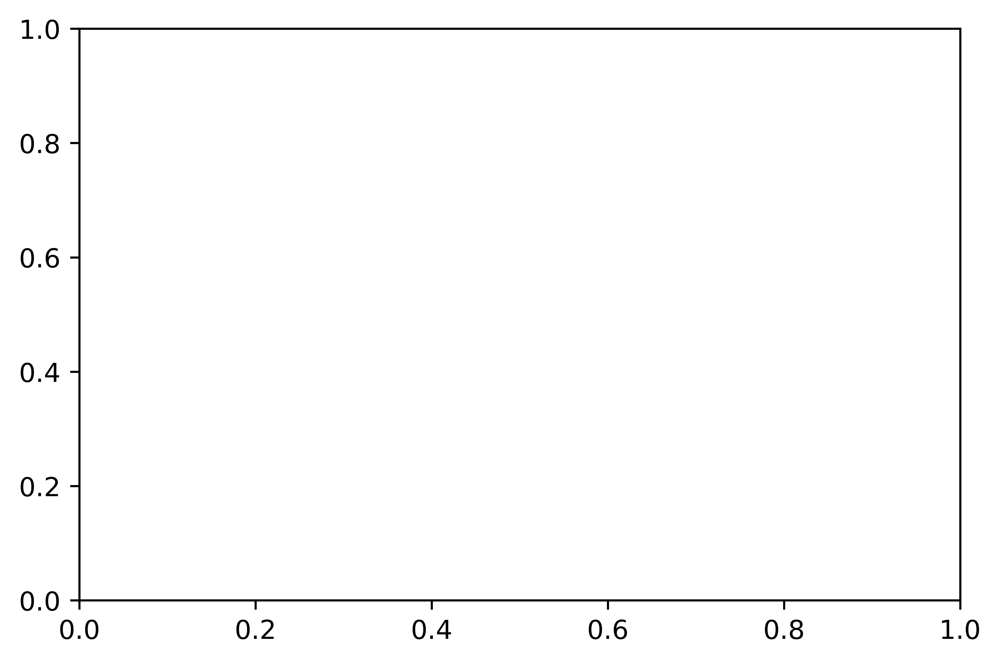

In [134]:
global_label_plot(data_subset, output='/QRISdata/Q1851/Minh/RNAScope/SkinSpatial',
                  name='scater_plot_label_transfer_scaterPlot60', dpi=800)

## Preprocess data with filtering, normalize by total, log1p, scale and PCA

In [13]:
print(data_subset.n_vars)

33538


In [14]:
st.pp.filter_genes(data_subset,min_cells=3)


In [15]:
st.pp.normalize_total(data_subset)


Normalization step is finished in adata.X


In [16]:
data_subset.obsm['normalized'] = pd.DataFrame(data_subset.X.toarray(),
                                              index=data_subset.obs_names, 
                                              columns=data_subset.var_names)

In [17]:
st.pp.log1p(data_subset)


Log transformation step is finished in adata.X


In [18]:
st.pp.scale(data_subset)


Scale step is finished in adata.X


In [19]:
st.em.run_pca(data_subset,n_comps=50)

PCA is done! Generated in adata.obsm['X_pca'], adata.uns['pca'] and adata.varm['PCs']


In [20]:
?st.pp.tiling

In [21]:

st.pp.tiling(data_subset,out_path="./temp_tiling",crop_size=40)
st.pp.extract_feature(data_subset)
st.spatial.morphology.adjust(data_subset,use_data='X_pca',radius=50,method="mean")
st.pp.neighbors(data_subset,n_neighbors=25,use_rep='X_pca_morphology')
# upload image without background for plotting
# st.add.image(adata=data, imgpath="C:\\Users\\uqjxu8\\GIH\\Bioinformatics\\SPA\\Data\\visium\\Human_Breast_Cancer_Block_A_Section_1\\spatial\\tissue_hires_nobg.png",
#             library_id="V1_Breast_Cancer_Block_A_Section_1",visium=True)

Tiling image: 100%|██████████ [ time left: 00:00 ]
Extract feature: 100%|██████████ [ time left: 00:00 ]


The morphology feature is added to adata.obsm['X_morphology']!


Adjusting data: 100%|██████████ [ time left: 00:00 ]


The data adjusted by morphology is added to adata.obsm['X_pca_morphology']
Created k-Nearest-Neighbor graph in adata.uns['neighbors'] 


In [22]:
st.tl.clustering.louvain(data_subset, resolution=0.9)


Applying Louvain clustering ...
Louvain clustering is done! The labels are stored in adata.obs['louvain']


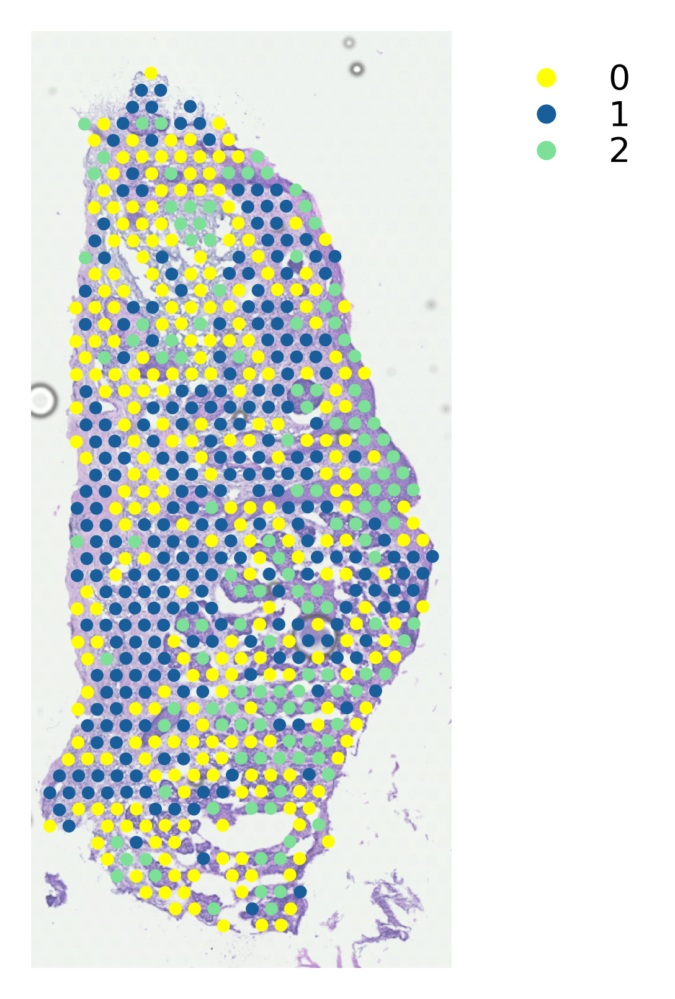

In [25]:
cluster_plot(data_subset,use_label="louvain", dpi=500, tissue_alpha=0.66, spot_size=9,cmap= "default_102",
            output='./', name='0708_st_clustering')

In [92]:
?st.pl.cluster_plot

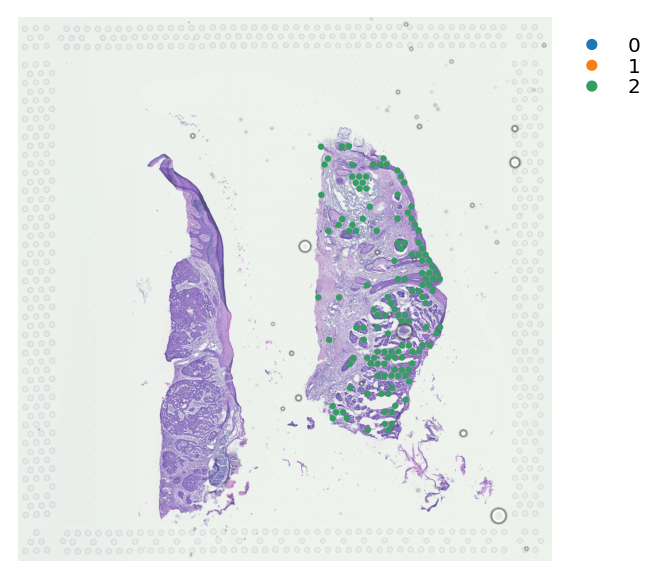

In [42]:
# xlim: 1043.237568 1601.828616
# ylim: 1596.500684 351.46194

st.pl.cluster_plot(data_subset, list_cluster=[2], use_label='louvain',tissue_alpha=0.75)
# plt.xlim([1043.237568, 1601.828616])
# plt.ylabel([1596.500684, 351.46194])

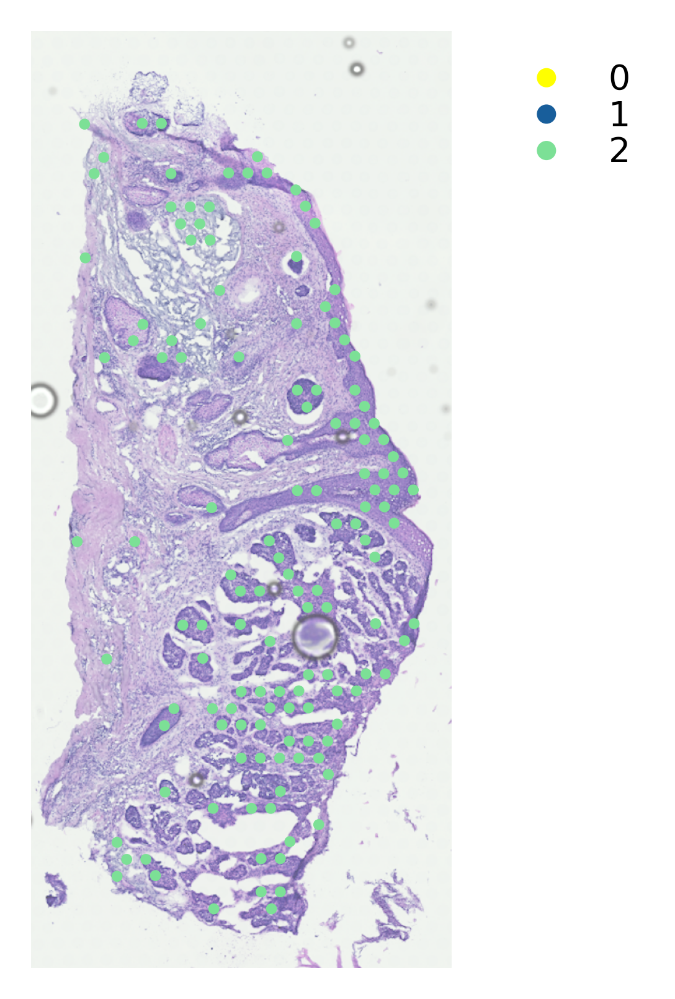

In [44]:
cluster_plot(data_subset, list_cluster=[2], use_label='louvain',tissue_alpha=0.66, 
             cmap= "default_102",
             output='./',name='0708_cluster2', dpi=500)

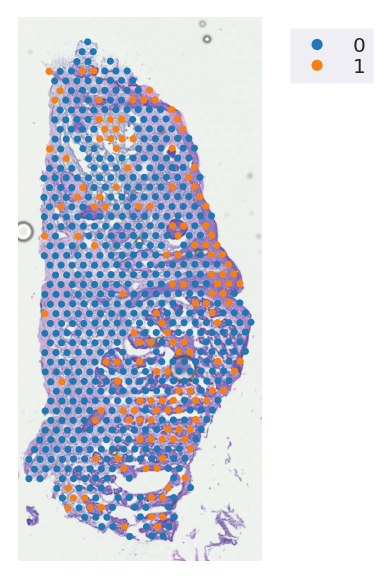

In [276]:
cluster_plot(data_subset, use_label="louvain", tissue_alpha=0.75,
             name='0707_cluster_result.pdf', output='.', spot_size=8)

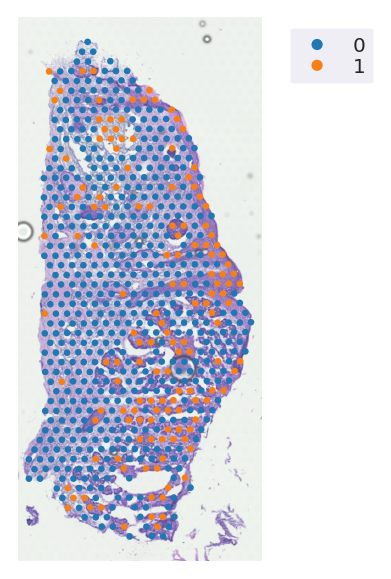

In [287]:
cluster_plot(data_subset, use_label="louvain", spot_size=7,
             tissue_alpha=0.75,name='0707_cluster_result_2mincells.pdf', output='.')

Applying Louvain clustering ...
Louvain clustering is done! The labels are stored in adata.obs['louvain']


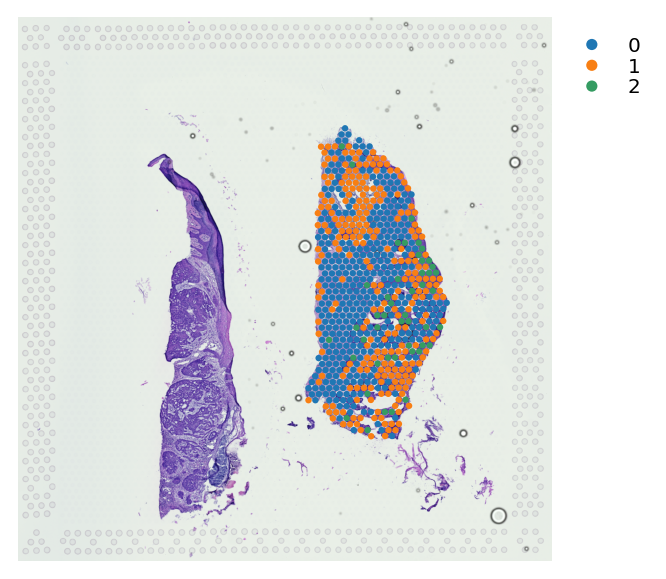

In [35]:

st.tl.clustering.louvain(data_subset, resolution=0.7)
st.pl.cluster_plot(data_subset,use_label="louvain")

#### Cell type heterogeneity

In [26]:
st.tl.clustering.louvain(data_subset, resolution=0.9)

Applying Louvain clustering ...
Louvain clustering is done! The labels are stored in adata.obs['louvain']


In [41]:
# size= {'xlim':[1043.237568, 1601.828616],'ylim':[1596.500684, 351.46194]}
# 1601.828616 - 1043.237568 = 558.591048
# 1596.500684 - 351.46194 = 1245.038744
# 1245.038744 / 558.591048 = 2.2288913301739846
40 / 2.2288913301739846

17.946141859180567

In [134]:
counts = st.tl.cci.het.count(data_subset, use_clustering='louvain', num_row=40, num_col=18)

Counts for cluster (cell type) diversity stored into data.uns['het']


In [135]:
print(counts)
counts.uns['het'].head()

AnnData object with n_obs × n_vars = 676 × 14595 
    obs: 'imagerow', 'imagecol', 'tissue', 'tile_path', 'louvain', 'prediction', 'lr_neighbours_louvain'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mean', 'std'
    uns: 'spatial', 'log1p', 'pca', 'neighbors', 'louvain', 'tmp_color', 'het', 'cpdb', 'lr', 'lr_neighbours_louvain_max', 'merged'
    obsm: 'label', 'filtered_counts', 'normalized', 'X_pca', 'X_tile_feature', 'X_morphology', 'X_pca_morphology', 'lr_neighbours'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0
2,0,1,1,1,1,1,1,2,0,0,0,0,0,0,0,0,0,0
3,0,0,3,1,2,1,1,2,1,1,0,0,0,0,0,0,0,0
4,0,0,2,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0


In [136]:
data_subset

AnnData object with n_obs × n_vars = 676 × 14595 
    obs: 'imagerow', 'imagecol', 'tissue', 'tile_path', 'louvain', 'prediction', 'lr_neighbours_louvain'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mean', 'std'
    uns: 'spatial', 'log1p', 'pca', 'neighbors', 'louvain', 'tmp_color', 'het', 'cpdb', 'lr', 'lr_neighbours_louvain_max', 'merged'
    obsm: 'label', 'filtered_counts', 'normalized', 'X_pca', 'X_tile_feature', 'X_morphology', 'X_pca_morphology', 'lr_neighbours'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

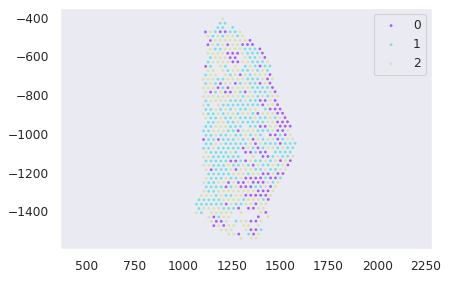

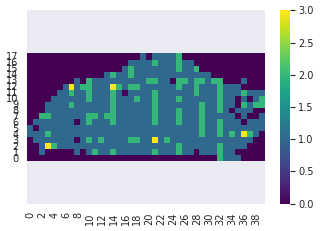

In [137]:
plt.ion()
het_plot(data_subset, use_cluster='louvain', het=counts.uns['het'], dpi=80, name='het_louvain', output='.')
plt.show()

### Cell-cell interaction based on spatial Ligand-Receptor (L-R) expression

In [45]:
data_subset.obsm['label'].head()

,T cells,macrophages/dendritic,pericytes,epidermal stem cell,vascular endothelial,differentiated keratinocytes,lymphatic endothelial cells,melanocytes,erythrocytes
AAACAAGTATCTCCCA-1,0.035814,0.257627,0.342138,0.069735,0.000000,0.267674,0.027012,0.000000,0.000000
AAACATTTCCCGGATT-1,0.085743,0.259431,0.099209,0.258701,0.016428,0.275348,0.005141,0.000000,0.000000
AAACGAGACGGTTGAT-1,0.909341,0.027789,0.016156,0.034395,0.000294,0.011885,0.000140,0.000000,0.000000
AAAGTGTGATTTATCT-1,0.033954,0.413388,0.057825,0.070385,0.336872,0.006954,0.035127,0.042808,0.002686
AAAGTTGACTCCCGTA-1,0.653707,0.113038,0.055600,0.013064,0.058039,0.023689,0.073247,0.009616,0.000000


In [46]:
data_subset.obsm["label"]['max_type'] =  data_subset.obsm["label"].idxmax(axis=1)
data_subset.obsm["label"].head()

,T cells,macrophages/dendritic,pericytes,epidermal stem cell,vascular endothelial,differentiated keratinocytes,lymphatic endothelial cells,melanocytes,erythrocytes,max_type
AAACAAGTATCTCCCA-1,0.035814,0.257627,0.342138,0.069735,0.000000,0.267674,0.027012,0.000000,0.000000,pericytes
AAACATTTCCCGGATT-1,0.085743,0.259431,0.099209,0.258701,0.016428,0.275348,0.005141,0.000000,0.000000,differentiated keratinocytes
AAACGAGACGGTTGAT-1,0.909341,0.027789,0.016156,0.034395,0.000294,0.011885,0.000140,0.000000,0.000000,T cells
AAAGTGTGATTTATCT-1,0.033954,0.413388,0.057825,0.070385,0.336872,0.006954,0.035127,0.042808,0.002686,macrophages/dendritic
AAAGTTGACTCCCGTA-1,0.653707,0.113038,0.055600,0.013064,0.058039,0.023689,0.073247,0.009616,0.000000,T cells


In [47]:
data_subset.obs['prediction'] = data_subset.obsm["label"]['max_type']

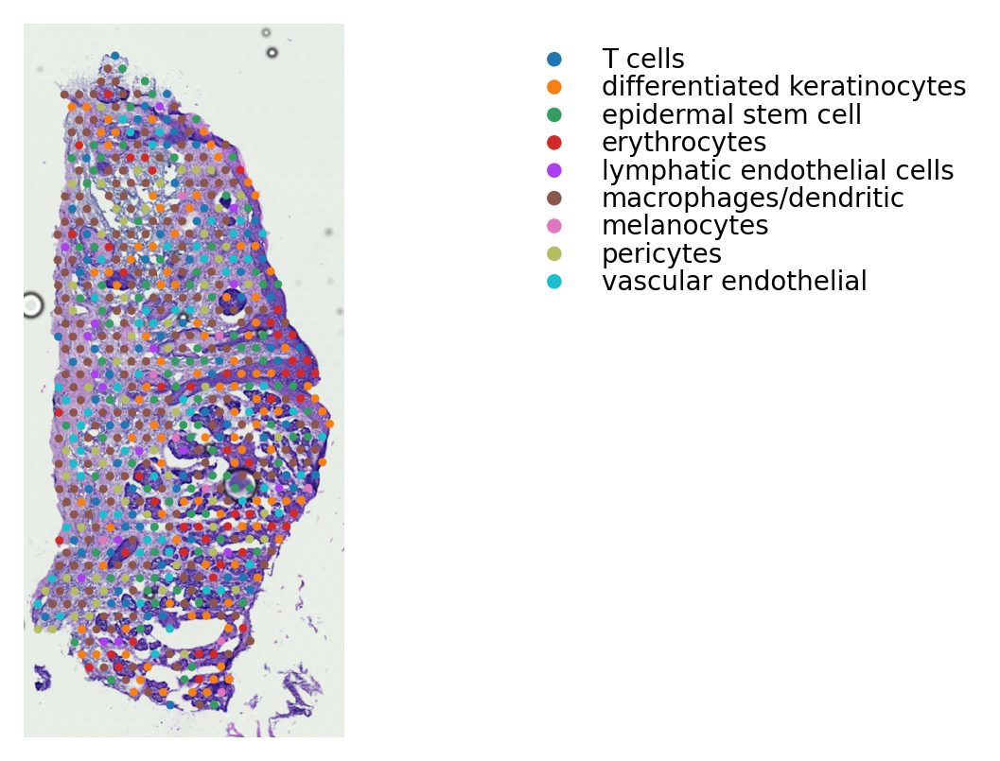

In [77]:
cluster_plot(data_subset,
                   use_label="prediction", dpi=250, name='label_transfer', 
                   output='.')

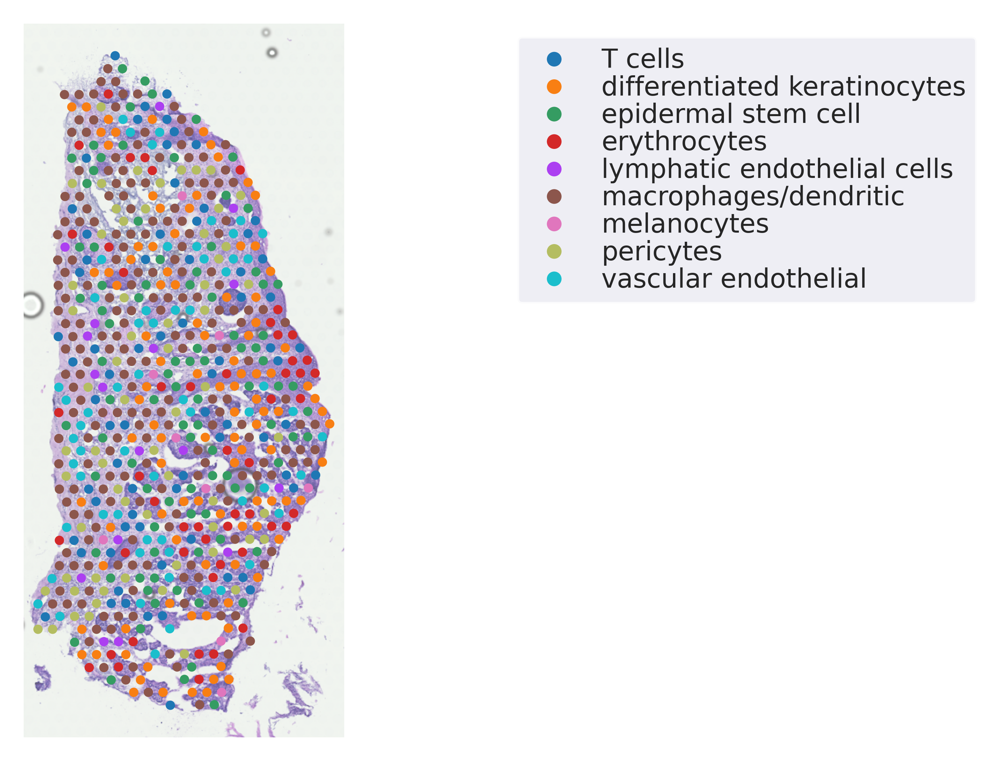

In [342]:
cluster_plot(data_subset,spot_size = 8, tissue_alpha=0.66, 
                   use_label="prediction", dpi=700, name='0708_label_transfer', 
                   output='.')

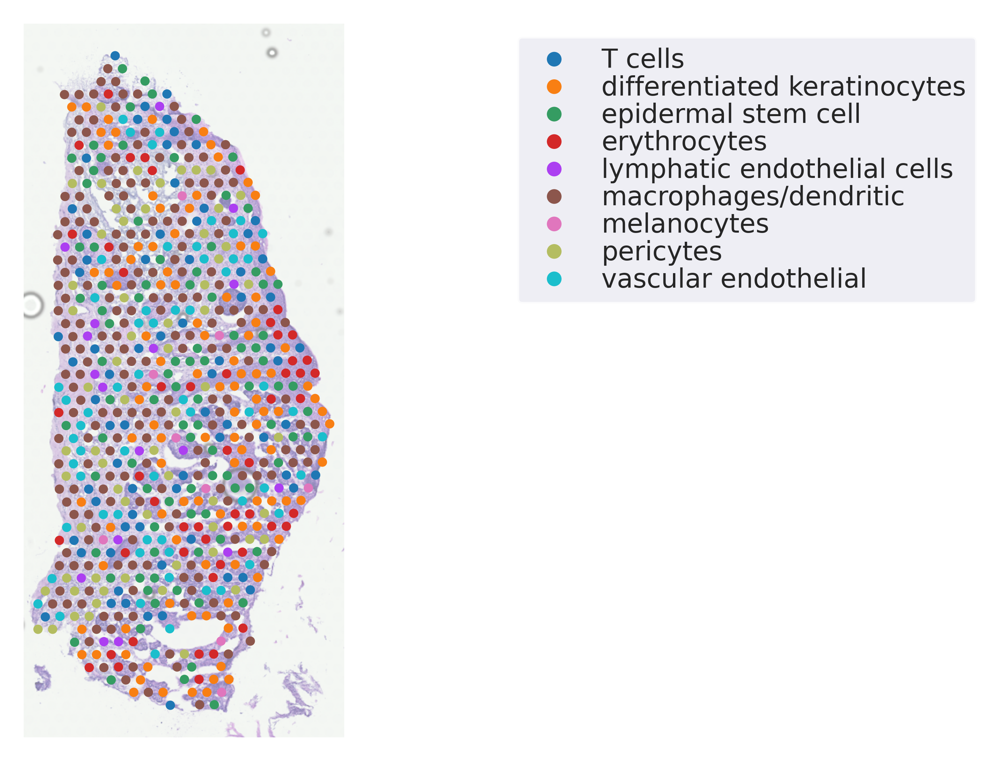

In [281]:
cluster_plot(data_subset,spot_size = 8,tissue_alpha=0.5,
                   use_label="prediction", dpi=700, name='0707_label_transfer', 
                   output='.')

Counts for cluster (cell type) diversity stored into data.uns['het']


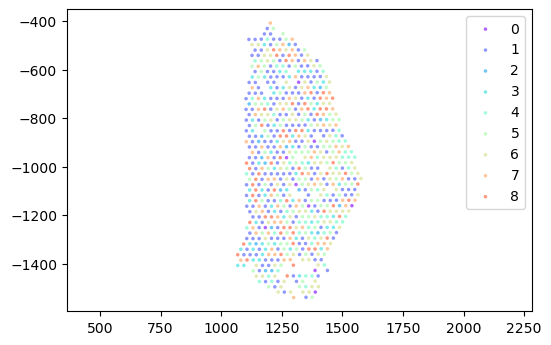

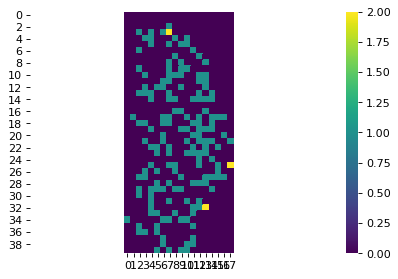

In [79]:

counts = st.tl.cci.het.count(data_subset, use_clustering='prediction', 
                             use_clusters=['T cells', 'differentiated keratinocytes'],
                             num_row=40, num_col=18)
plt.ion()
het_plot(data_subset, use_cluster='prediction', het=counts.uns['het'], dpi=100, name='0708_het_prediction', output='.')
plt.show()

# cluster spatial spots based on the proportion of known ligand-receptor co-expression among the neighbouring spots

In [80]:
st.add.cpdb(adata=data_subset, cpdb_filepath='means.txt', sep='\t')
st.add.lr(data_subset)


Added cpdb results to the object!
Added ligand receptor pairs to adata.uns['lr'].


In [82]:
data_subset.uns['lr'][0:20]

['KLRG2_WNT11',
 'KLRG2_TNFSF9',
 'HLA-DPA1_TNFSF9',
 'PVR_TNFSF9',
 'KLRG2_WNT5B',
 'HLA-DPA1_GAL',
 'GALR2_GAL',
 'GALR3_GAL',
 'PVR_CD96',
 'PVR_CD226',
 'PVR_TIGIT',
 'PVR_NECTIN3',
 'CADM3_NECTIN3',
 'CADM1_NECTIN3',
 'NECTIN1_NECTIN3',
 'TIGIT_NECTIN3',
 'NECTIN2_NECTIN3',
 'CADM3_CADM1',
 'CADM1_CADM1',
 'CRTAM_CADM1']

In [83]:
print(data_subset.uns['cpdb'].shape)
data_subset.uns['cpdb'].head()

(947, 20)


,id_cp_interaction,interacting_pair,partner_a,partner_b,gene_a,gene_b,secreted,receptor_a,receptor_b,annotation_strategy,is_integrin,0|0,0|1,0|2,1|0,1|1,1|2,2|0,2|1,2|2
0,CPI-SS0A7B487D4,KLRG2_WNT11,simple:A4D1S0,simple:O96014,ENSG00000188883,ENSG00000085741,True,True,False,InnateDB-All,False,0.009,0.006,0.026,0.009,0.006,0.027,0.000,0.0,0.000
1,CPI-SS0FEC87269,KLRG2_TNFSF9,simple:A4D1S0,simple:P41273,ENSG00000188883,ENSG00000125657,True,True,False,InnateDB-All,False,0.011,0.000,0.026,0.011,0.000,0.027,0.000,0.0,0.000
2,CPI-SS028784FC6,HLA-DPA1_TNFSF9,simple:HLADPA1,simple:P41273,ENSG00000231389,ENSG00000125657,True,True,False,InnateDB-All,False,0.378,0.000,0.394,0.143,0.000,0.159,0.975,0.0,0.991
3,CPI-SS00A8596B5,PVR_TNFSF9,simple:P15151,simple:P41273,ENSG00000073008,ENSG00000125657,True,True,False,InnateDB-All,False,0.029,0.000,0.044,0.020,0.000,0.035,0.065,0.0,0.080
4,CPI-SS044DF8749,KLRG2_WNT5B,simple:A4D1S0,simple:Q9H1J7,ENSG00000188883,ENSG00000111186,True,True,False,InnateDB-All,False,0.014,0.000,0.045,0.015,0.000,0.045,0.000,0.0,0.000


In [84]:
st.tl.cci.base.lr(adata=data_subset, use_data='normalized', threshold=0.75, distance=30)

Altogether 892 valid L-R pairs
L-R interactions with neighbours are counted and stored into adata\.obsm['lr_neighbours']
Created k-Nearest-Neighbor graph in adata.uns['neighbors'] 
Applying Louvain clustering ...
Louvain clustering is done! The labels are stored in adata.obs['louvain']
Spatial distribution of LR co-expression is written to adata.obsm['lr_neighbours']
Result of LR-clustering is kept in adata.obs['lr_neighbours_louvain']
The largest expressed LR neighbouring cluster is:  3


AnnData object with n_obs × n_vars = 676 × 14595 
    obs: 'imagerow', 'imagecol', 'tissue', 'tile_path', 'louvain', 'prediction', 'lr_neighbours_louvain'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mean', 'std'
    uns: 'spatial', 'log1p', 'pca', 'neighbors', 'louvain', 'tmp_color', 'het', 'cpdb', 'lr', 'lr_neighbours_louvain_max'
    obsm: 'label', 'filtered_counts', 'normalized', 'X_pca', 'X_tile_feature', 'X_morphology', 'X_pca_morphology', 'lr_neighbours'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

ValueError: Did not find lr_neigbours in `.obsm.keys()`. You need to compute it first.

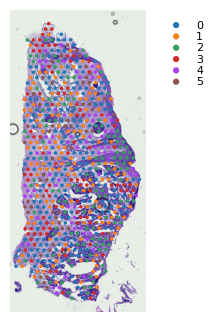

In [86]:
cluster_plot(data_subset,use_label="lr_neighbours_louvain", dpi=100)

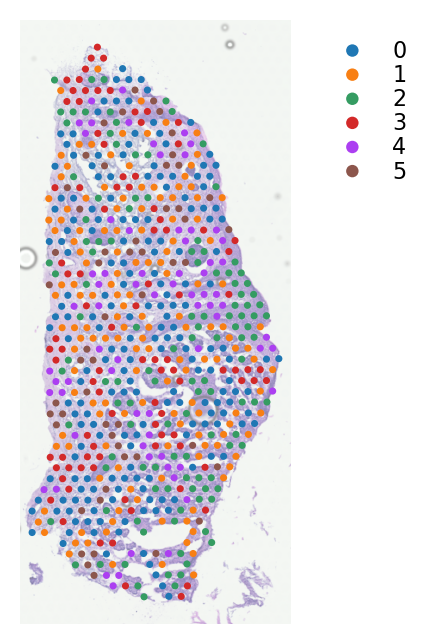

In [87]:
cluster_plot(data_subset,use_label="lr_neighbours_louvain",tissue_alpha=0.5, dpi=200)

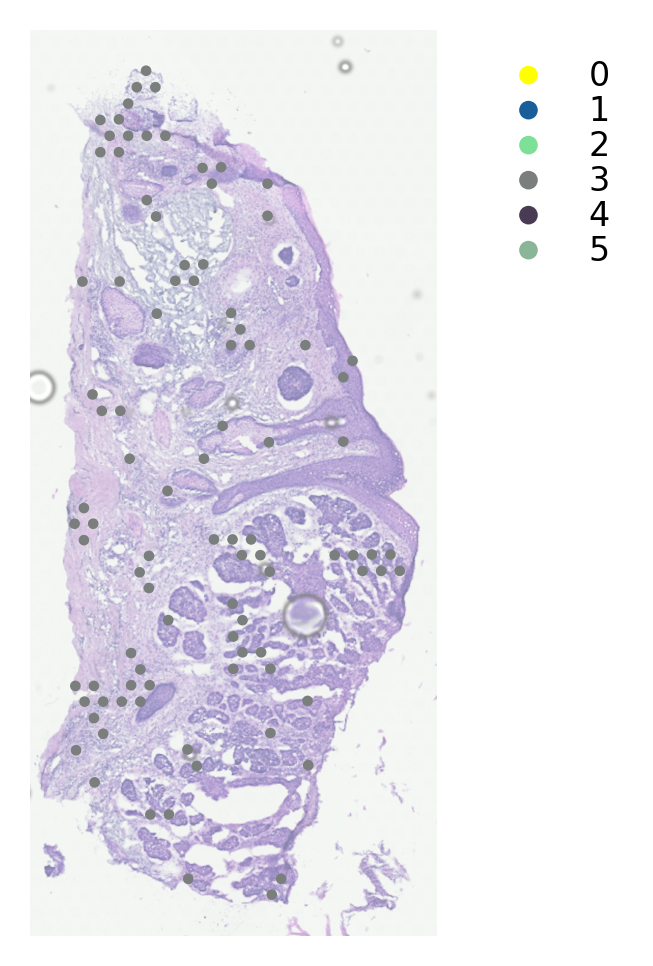

In [88]:
cluster_plot(data_subset,use_label="lr_neighbours_louvain",
             list_cluster=[data_subset.uns['lr_neighbours_louvain_max']],
             cmap='default_102', dpi=300, name='lr_neighbours_louvain', output='.',
            tissue_alpha=0.5)

In [89]:
rank_test = AnnData(data_subset.obsm['lr_neighbours'])
rank_test.obs['lr_neighbours_louvain'] = data_subset.obs['lr_neighbours_louvain']
sc.tl.rank_genes_groups(rank_test, 'lr_neighbours_louvain', method='t-test')
pd.DataFrame(rank_test.uns['rank_genes_groups']['names']).iloc[0:15,]

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


,0,1,2,3,4,5
0,APP_CD74,CD74_MIF,PTN_PLXNB2,FGFR2_TIMP1,FGFR3_NECTIN1,COPA_CD74
1,CD74_APP,MIF_CD74,PLXNB2_PTN,TIMP1_FGFR2,NECTIN1_FGFR3,CD74_COPA
2,ICAM1_ITGAL,PDGFRA_PDGFA,TNFSF14_LTBR,TNFRSF1A_GRN,FGFR2_NECTIN1,EGFR_COPA
3,ITGAL_ICAM1,PDGFA_PDGFRA,LTBR_TNFSF14,GRN_TNFRSF1A,NECTIN1_FGFR2,COPA_EGFR
4,TNFRSF1A_GRN,HLA-DPA1_TNFSF9,EFNA5_EPHA1,FGFR2_FGFR3,TNFSF12_TNFRSF25,COPA_SORT1
5,GRN_TNFRSF1A,TNFSF9_HLA-DPA1,EPHA1_EFNA5,FGFR3_FGFR2,TNFRSF25_TNFSF12,SORT1_COPA
6,CXCL12_DPP4,LTBR_LTB,TNFRSF1B_LTA,FGFR2_CD44,NECTIN1_NECTIN4,DSC3_DSG1
7,DPP4_CXCL12,LTB_LTBR,LTA_TNFRSF1B,CD44_FGFR2,NECTIN4_NECTIN1,DSG1_DSC3
8,ANTXR1_GDF11,DSG1_DSC1,NAMPT_NTRK1,NECTIN1_FGFR2,SMO_WNT4,GAL_HLA-DPA1
9,GDF11_ANTXR1,DSC1_DSG1,WNT5A_FZD5,FGFR2_NECTIN1,WNT4_SMO,HLA-DPA1_GAL


/90days/s4596423/envs/stlearn/lib/python3.7/site-packages/stlearn/plotting/cci_plot.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  violin['cci_cluster'] = adata.obs['lr_neighbours_' + use_cluster]


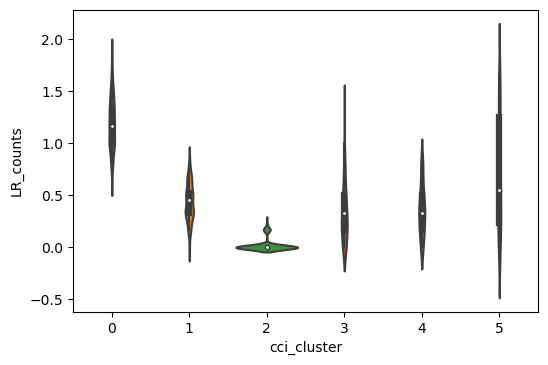

In [90]:

st.pl.violin_plot(data_subset, lr='CD74_APP', use_cluster='louvain', dpi=100, name='violin', output='.')

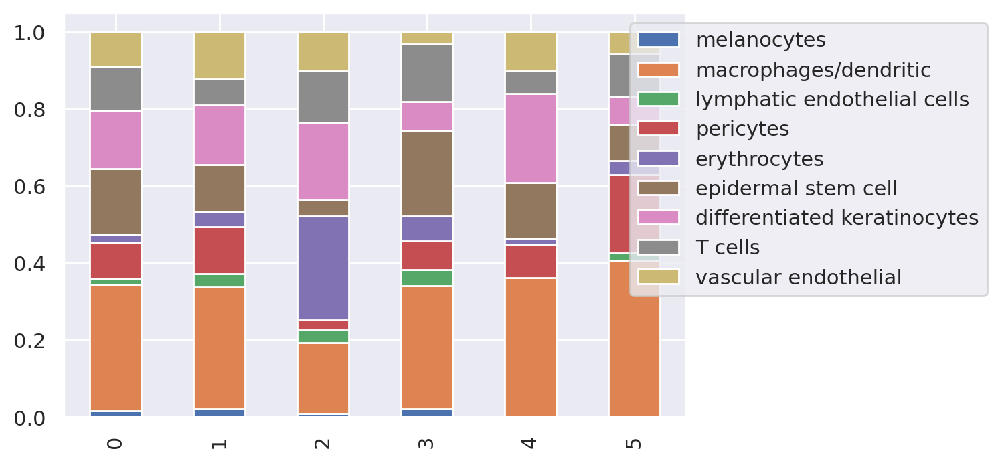

In [94]:
st.pl.stacked_bar_plot(data_subset, use_annotation='prediction', 
                       dpi=200, name='stacked_bar', output='.')

### Merge results from cci clustering and cell type heterogeneity

In [95]:
st.tl.cci.merge(data_subset, use_lr='lr_neighbours_louvain_max', use_het='het')

Results of spatial interaction analysis has been written to adata.uns['merged']


AnnData object with n_obs × n_vars = 676 × 14595 
    obs: 'imagerow', 'imagecol', 'tissue', 'tile_path', 'louvain', 'prediction', 'lr_neighbours_louvain'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mean', 'std'
    uns: 'spatial', 'log1p', 'pca', 'neighbors', 'louvain', 'tmp_color', 'het', 'cpdb', 'lr', 'lr_neighbours_louvain_max', 'merged'
    obsm: 'label', 'filtered_counts', 'normalized', 'X_pca', 'X_tile_feature', 'X_morphology', 'X_pca_morphology', 'lr_neighbours'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

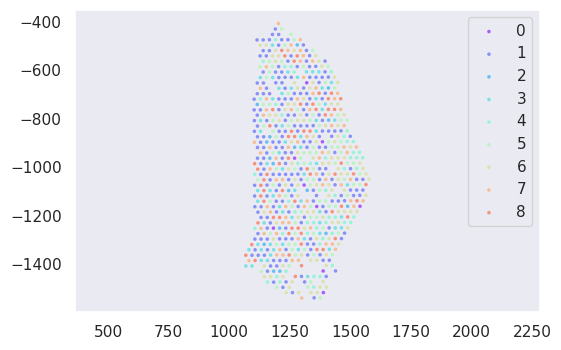

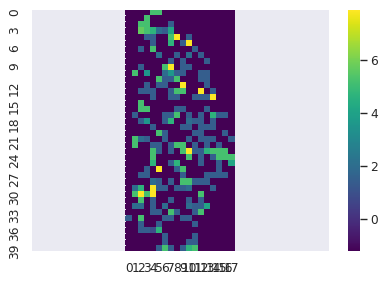

In [96]:
het_plot(data_subset, use_cluster='prediction', 
               het=data_subset.uns['merged'], dpi=100, name='final', output='.')

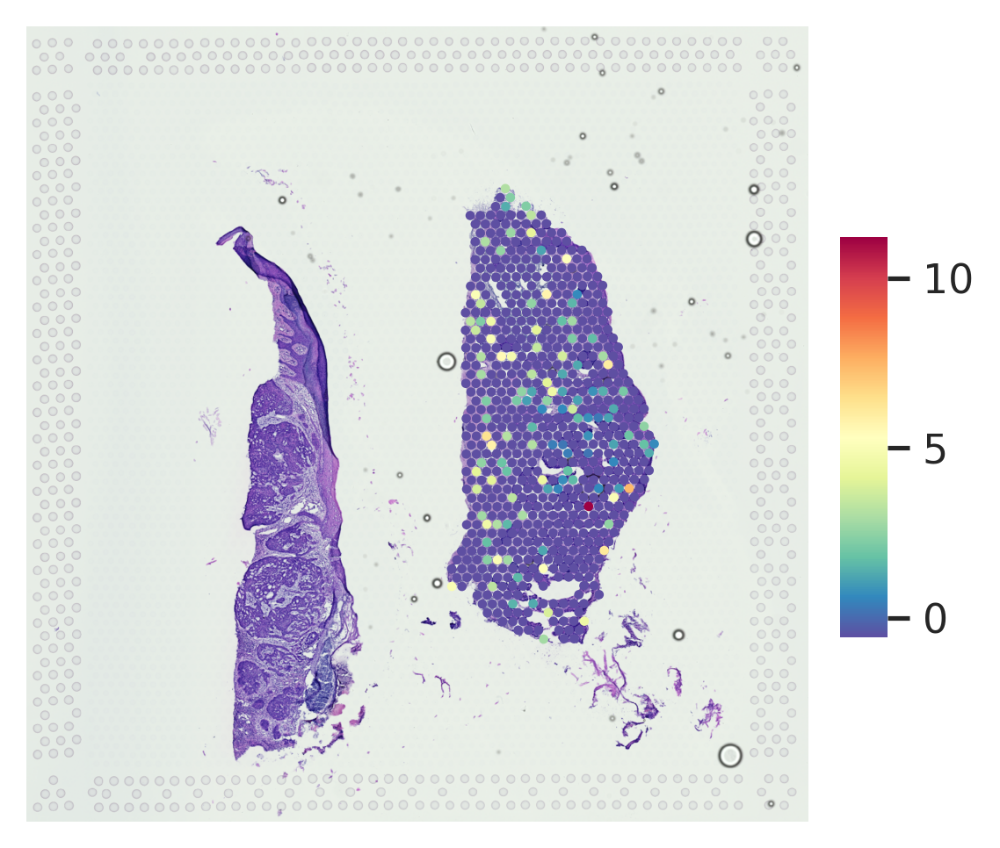

In [97]:

st.pl.gene_plot(data_subset, genes=['IL34','CSF1R'], method="CumSum", dpi=300)

checkpoint  {'xlim': [1043.237568, 1601.828616], 'ylim': [1596.500684, 351.46194]}


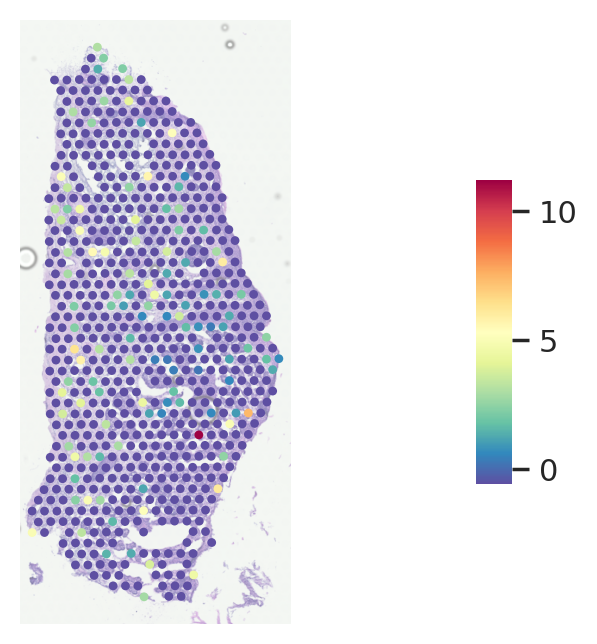

In [100]:
gene_plot(data_subset, genes=['IL34','CSF1R'], method="CumSum", dpi=200, spot_size=10,
          show_color_bar=True, tissue_alpha=0.5)

checkpoint  {'xlim': [1043.237568, 1601.828616], 'ylim': [1596.500684, 351.46194]}


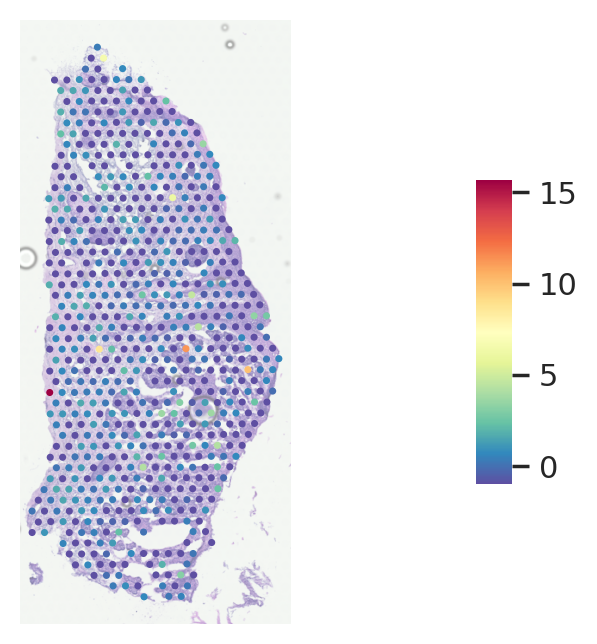

In [275]:
gene_plot(data_subset, genes=['ITGAM','THY1'], method="CumSum", dpi=200, tissue_alpha=0.5, show_color_bar=True)

In [105]:
gene_plot(data_subset, genes=['CD4','CD8'], method="CumSum", spot_size=10,
          dpi=200, tissue_alpha=0.5)

NameError: name 'warnings' is not defined

In [70]:
data_subset

AnnData object with n_obs × n_vars = 676 × 368 
    obs: 'imagerow', 'imagecol', 'tissue', 'tile_path', 'louvain', 'prediction'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mean', 'std'
    uns: 'spatial', 'log1p', 'pca', 'neighbors', 'louvain', 'tmp_color', 'cpdb', 'lr'
    obsm: 'label', 'filtered_counts', 'X_pca', 'normalized', 'X_tile_feature', 'X_morphology', 'X_pca_morphology', 'lr_neighbours'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [69]:
data_subset.uns['neighbors']

{'connectivities_key': 'connectivities',
 'distances_key': 'distances',
 'params': {'n_neighbors': 25,
  'method': 'umap',
  'metric': 'euclidean',
  'use_rep': 'X_pca_morphology'}}

In [72]:
data_subset.obsp['distances'].shape

(676, 676)

1068.237568 1576.828616
407.46194 1540.500684


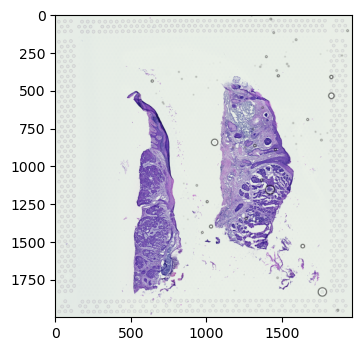

In [87]:
fix, ax = plt.subplots()
ax.imshow(data_subset.uns['spatial']['whatever']['images']['hires'])
print(data_subset.obs['imagecol'].min(), data_subset.obs['imagecol'].max())
print(data_subset.obs['imagerow'].min(), data_subset.obs['imagerow'].max())

In [24]:
def cluster_plot(
    adata: AnnData,
    library_id: str = None,
    use_label: str = "louvain",
    list_cluster: list = None,
    data_alpha: float = 1.0,
    cmap: str = "vega_20_scanpy",
    tissue_alpha: float = 1.0,
    title: str = None,
    plot_lim: dict = {'xlim':[1043.237568, 1601.828616],'ylim':[1596.500684, 351.46194]},
    spot_size: Union[float, int] = 6.5,
    show_axis: bool = False,
    show_legend: bool = True,
    dpi: int = 180,
    show_trajectory: bool = False,
    show_subcluster: bool = False,
    name: str = None,
    output: str = None,
    copy: bool = False,
) -> Optional[AnnData]:

    """\
    Clustering plot for sptial transcriptomics data. Also it has a function to display trajectory inference.
    Parameters
    ----------
    adata
        Annotated data matrix.
    library_id
        Library id stored in AnnData.
    use_label
        Use label result of clustering method.
    list_cluster
        Choose set of clusters that will display in the plot.
    data_alpha
        Opacity of the spot.
    tissue_alpha
        Opacity of the tissue.
    cmap
        Color map to use.
    spot_size
        Size of the spot.
    show_axis
        Show axis or not.
    show_legend
        Show legend or not.
    dpi
        Set dpi as the resolution for the plot.
    show_trajectory
        Show the spatial trajectory or not. It requires stlearn.spatial.trajectory.pseudotimespace.
    show_subcluster
        Show subcluster or not. It requires stlearn.spatial.trajectory.global_level.
    name
        Name of the output figure file.
    output
        Save the figure as file or not.
    copy
        Return a copy instead of writing to adata.
    Returns
    -------
    Nothing
    """

    plt.rcParams['figure.dpi'] = dpi

    n_clusters = len(adata.obs[use_label].unique())

    # Option for turning off showing figure
    plt.ioff()

    # Initialize matplotlib
    fig, a = plt.subplots()

    if show_trajectory:

        if not adata.uns["PTS_graph"]:
            raise ValueError(
                "Please run stlearn.spatial.trajectory.pseudotimespace!")

        tmp = adata.uns["PTS_graph"]

        G = tmp.copy()

        remove = [edge for edge in G.edges if 9999 in edge]
        G.remove_edges_from(remove)
        G.remove_node(9999)
        centroid_dict = adata.uns["centroid_dict"]
        nx.draw_networkx_edges(G, pos=centroid_dict, node_size=1, alpha=1.0,
                               font_size=5, linewidths=1, edge_color='#f4efd3', arrowsize=5, arrowstyle='->', connectionstyle="arc3,rad=0.2")

    from scanpy.plotting import palettes
    if cmap == "vega_10_scanpy":
        cmap = palettes.vega_10_scanpy
    elif cmap == "vega_20_scanpy":
        cmap = palettes.vega_20_scanpy
    elif cmap == "default_102":
        cmap = palettes.default_102
    elif cmap == "default_28":
        cmap = palettes.default_28
    else:
        raise ValueError(
            "We only support vega_10_scanpy, vega_20_scanpy, default_28, default_102")

    cmaps = matplotlib.colors.LinearSegmentedColormap.from_list("", cmap)

    cmap_ = plt.cm.get_cmap(cmaps)

    if list_cluster is not None:
        tmp = adata.obs.loc[adata.obs[use_label].isin(
            np.array(list_cluster).astype(str))]
    else:
        tmp = adata.obs

    # Plot scatter plot based on pixel of spots
    adata.uns["tmp_color"] = []

    for i, cluster in enumerate(tmp.groupby(use_label)):

        _ = a.scatter(cluster[1]['imagecol'], cluster[1]['imagerow'], c=[cmap_(int(i)/19)], label=cluster[0],
                      edgecolor="none", alpha=data_alpha, s=spot_size, marker="o")

        adata.uns["tmp_color"].append(
            matplotlib.colors.to_hex(cmap_(int(i)/19)))

    if show_legend:
        lgnd = a.legend(bbox_to_anchor=(1.5, 1.0), labelspacing=0.05,
                        fontsize=8, handleheight=1., edgecolor='white')
        for handle in lgnd.legendHandles:
            handle.set_sizes([20.0])

    if not show_axis:
        a.axis('off')


    if library_id is None:
        library_id = list(adata.uns["spatial"].keys())[0]

    image = adata.uns["spatial"][library_id]["images"][adata.uns["spatial"]["use_quality"]]

    
    # Overlay the tissue image
    a.imshow(image, alpha=tissue_alpha, zorder=-1,)
    plt.xlim(plot_lim['xlim'])
    plt.ylim(plot_lim['ylim'])
    if name is None:
        name = use_label

    if output is not None:
        fig.savefig(output + "/" + name + ".pdf", dpi=dpi,
                    bbox_inches='tight', pad_inches=0)

    if show_subcluster:
        if "sub_cluster_labels" not in adata.obs.columns:
            raise ValueError("Please run stlearn.spatial.cluster.localization")

        for cluster in list_cluster:
            if len(adata.obs[adata.obs[use_label] == str(cluster)]["sub_cluster_labels"].unique()) < 2:
                centroids = [centroidpython(adata.obs[adata.obs[use_label] == str(cluster)][[
                                            "imagecol", "imagerow"]].values)]
                classes = np.array(
                    [adata.obs[adata.obs[use_label] == str(cluster)]["sub_cluster_labels"][0]])

            else:
                from sklearn.neighbors import NearestCentroid
                clf = NearestCentroid()
                clf.fit(adata.obs[adata.obs[use_label] == str(cluster)][["imagecol", "imagerow"]].values,
                        adata.obs[adata.obs[use_label] == str(cluster)]["sub_cluster_labels"])

                centroids = clf.centroids_
                classes = clf.classes_

            for i, label in enumerate(classes):
                if centroids[i][0] < 1500:
                    x = -100
                    y = 50
                else:
                    x = 100
                    y = -50
                a.text(centroids[i][0]+x, centroids[i][1]+y, label, color='black', fontsize=5, zorder=3,
                       bbox=dict(facecolor=adata.uns["tmp_color"][int(cluster)], boxstyle='round', alpha=1.0))

    plt.show()


def centroidpython(data):
    x, y = zip(*data)
    l = len(x)
    return sum(x) / l, sum(y) / l

In [229]:
data_subset.obsm['normalized']['KLRG2']

AAACAAGTATCTCCCA-1    0.0
AAACATTTCCCGGATT-1    0.0
AAACGAGACGGTTGAT-1    0.0
AAAGTGTGATTTATCT-1    0.0
AAAGTTGACTCCCGTA-1    0.0
                     ... 
TTGGCCTAGAATTTCG-1    0.0
TTGGGCGGCGGTTGCC-1    0.0
TTGTAAGGCCAGTTGG-1    0.0
TTGTGGTGGTACTAAG-1    0.0
TTGTTGTGTGTCAAGA-1    0.0
Name: KLRG2, Length: 676, dtype: float32

In [142]:
data_subset.uns['lr']

['KLRG2_WNT11',
 'KLRG2_TNFSF9',
 'HLA-DPA1_TNFSF9',
 'PVR_TNFSF9',
 'KLRG2_WNT5B',
 'HLA-DPA1_GAL',
 'GALR2_GAL',
 'GALR3_GAL',
 'PVR_CD96',
 'PVR_CD226',
 'PVR_TIGIT',
 'PVR_NECTIN3',
 'CADM3_NECTIN3',
 'CADM1_NECTIN3',
 'NECTIN1_NECTIN3',
 'TIGIT_NECTIN3',
 'NECTIN2_NECTIN3',
 'CADM3_CADM1',
 'CADM1_CADM1',
 'CRTAM_CADM1',
 'CADM3_CADM4',
 'CADM3_EPB41L1',
 'NECTIN1_CADM3',
 'NECTIN1_NECTIN4',
 'TIGIT_NECTIN2',
 'CD226_NECTIN2',
 'CDH1_KLRG1',
 'FGF2_CD44',
 'SPP1_CD44',
 'LGALS9_CD44',
 'HGF_CD44',
 'FGF2_FGFR4',
 'FGF1_FGFR4',
 'TNFRSF10A_FGFR4',
 'FGF18_FGFR4',
 'FGF19_FGFR4',
 'FGF7_FGFR4',
 'FGF2_FGFR1',
 'FGF1_FGFR1',
 'FGF18_FGFR1',
 'FGF19_FGFR1',
 'FGF10_FGFR1',
 'FGF2_FGFR2',
 'FGF1_FGFR2',
 'CD44_FGFR2',
 'FGF18_FGFR2',
 'FGF7_FGFR2',
 'FGF10_FGFR2',
 'TIMP1_FGFR2',
 'FGFR1_FGFR2',
 'FGF2_FGFR3',
 'FGF1_FGFR3',
 'FGF18_FGFR3',
 'FGF7_FGFR3',
 'FGFR2_FGFR3',
 'FGF2_FGFRL1',
 'SPP1_PTGER4',
 'FGF1_TGFBR3',
 'TGFB1_TGFBR3',
 'INHA_TGFBR3',
 'TGFB3_TGFBR3',
 'TGFB2_TGFBR3',
 

In [116]:
def gene_plot(
    adata: AnnData,
    method: str = "CumSum",
    genes: Optional[Union[str, list]] = None,
    threshold: float = None,
    title: str = 'Gene_marker_here',
    library_id: str = None,
    data_alpha: float = 1.0,
    tissue_alpha: float = 1.0,
    cmap: str = "Spectral_r",
    spot_size: Union[float, int] = 6.5,
    show_legend: bool = False,
    plot_lim: dict = {'xlim':[1043.237568, 1601.828616],'ylim':[1596.500684, 351.46194]},
    show_color_bar: bool = True,
    show_axis: bool = False,
    dpi: int = 192,
    name: str = None,
    output: str = None,
    copy: bool = False,
) -> Optional[AnnData]:
    """\
    Gene expression plot for sptial transcriptomics data.
    Parameters
    ----------
    adata
        Annotated data matrix.
    library_id
        Library id stored in AnnData.
    method
        Use method to count. We prorive: NaiveMean, NaiveSum, CumSum.
    genes
        Choose a gene or a list of genes.
    threshold
        Threshold to filter genes
    data_alpha
        Opacity of the spot.
    tissue_alpha
        Opacity of the tissue.
    cmap
        Color map to use.
    spot_size
        Size of the spot.
    show_color_bar
        Show color bar or not.
    show_axis
        Show axis or not.
    show_legend
        Show legend or not.
    dpi
        Set dpi as the resolution for the plot.
    show_trajectory
        Show the spatial trajectory or not. It requires stlearn.spatial.trajectory.pseudotimespace.
    show_subcluster
        Show subcluster or not. It requires stlearn.spatial.trajectory.global_level.
    name
        Name of the output figure file.
    output
        Save the figure as file or not.
    copy
        Return a copy instead of writing to adata.
    Returns
    -------
    Nothing
    """

    plt.rcParams['figure.dpi'] = dpi

    if type(genes) == str:
        genes = [genes]
    colors = _gene_plot(adata, method, genes)

    if threshold is not None:
        colors = colors[colors>threshold]

    index_filter = colors.index

    filter_obs  = adata.obs.loc[index_filter]
    imagecol = filter_obs["imagecol"]
    imagerow = filter_obs["imagerow"]


    # Option for turning off showing figure
    plt.ioff()

    # Initialize matplotlib
    fig, a = plt.subplots()

    vmin = min(colors)
    vmax = max(colors)
    # Plot scatter plot based on pixel of spots
    plot = a.scatter(imagecol, imagerow, edgecolor="none", alpha=data_alpha, s=spot_size, marker="o",
                     vmin=vmin, vmax=vmax, cmap=plt.get_cmap(cmap), c=colors)

    if show_color_bar:

        cb = plt.colorbar(plot, cax=fig.add_axes(
            [0.78, 0.3, 0.03, 0.38]), cmap=cmap)
        cb.ax.set_xlabel(title, fontsize=8)
        cb.outline.set_visible(True)

    if not show_axis:
        a.axis('off')

    if library_id is None:
        library_id = list(adata.uns["spatial"].keys())[0]

    image = adata.uns["spatial"][library_id]["images"][adata.uns["spatial"]["use_quality"]]
    # Overlay the tissue image
    a.imshow(image, alpha=tissue_alpha, zorder=-1,)
    print('checkpoint ', plot_lim)
    a.set_xlim(1043.237568, 1601.828616)
    a.set_ylim(1596.500684, 351.46194)
    if name is None:
        name = method
    if output is not None:
        fig.savefig(output + "/" + name + ".png", dpi=dpi,
                    bbox_inches='tight', pad_inches=0)
#     plt.xlim(plot_lim['xlim'])
#     plt.ylim(plot_lim['ylim'])
    plt.show()
    # Store figure
    #fig_np = get_img_from_fig(fig,dpi)
    # plt.close(fig)
    # if "plots" not in adata.uns:
    #    adata.uns['plots'] = {}
    #adata.uns['plots'].update({str(', '.join(genes)):fig_np})
    # print("The plot stored in adata.uns['plot']['" +
    #    str(', '.join(genes)) + "']")


def _gene_plot(adata, method, genes):

    # Gene plot option

    if len(genes) == 0:
        raise ValueError('Genes shoule be provided, please input genes')

    elif len(genes) == 1:

        if genes[0] not in adata.var.index:
            raise ValueError(
                genes[0] + ' is not exist in the data, please try another gene')

        colors = adata[:, genes].to_df().iloc[:, -1]

        return colors
    else:

        for gene in genes:
            if gene not in adata.var.index:
                genes.remove(gene)
#                 warnings.warn("We removed " + gene +" because they not exist in the data")

            if len(genes) == 0:
                raise ValueError(
                    'All provided genes are not exist in the data')

        count_gene = adata[:, genes].to_df()

        if method is None:
            raise ValueError(
                'Please provide method to combine genes by NaiveMean/NaiveSum/CumSum')

        if method == "NaiveMean":
            present_genes = (count_gene > 0).sum(axis=1) / len(genes)

            count_gene = (count_gene.mean(axis=1)) * present_genes
        elif method == "NaiveSum":
            present_genes = (count_gene > 0).sum(axis=1) / len(genes)

            count_gene = (count_gene.sum(axis=1)) * present_genes

        elif method == "CumSum":
            count_gene = count_gene.cumsum(axis=1).iloc[:, -1]

        colors = count_gene

        return colors

In [131]:
def het_plot(
    adata: AnnData,
    het: pd.DataFrame,
    use_cluster: str = 'louvain',
    dpi: int = 100,
    spot_size: Union[float,int] = 6.5,
    vmin: int = None,
    vmax: int = None,
    name: str = None,
    output: str = None,
):
    """ Plot tissue clusters and cluster heterogeneity using heatmap
    Parameters
    ----------
    adata: AnnData                  The data object to plot
    het: pd.DataFrame               Cluster heterogeneity count results from tl.cci.het
    use_cluster: str                The clustering results to use
    dpi: bool                       Dots per inch
    spot_size: Union[float,int]     Spot size
    
    Returns
    -------
    N/A
    """

    

    plt.rcParams['figure.dpi'] = dpi
    fig, ax = plt.subplots()
    num_clusters = len(set(adata.obs[use_cluster])) + 1
    ax.set_prop_cycle('color',plt.cm.rainbow(np.linspace(0,1,num_clusters)))
    for item in set(adata.obs[use_cluster]):
        ax.scatter(np.array(adata.obs[adata.obs[use_cluster]==item]['imagecol']), 
                   -np.array(adata.obs[adata.obs[use_cluster]==item]['imagerow']), 
                   alpha=0.6, s=spot_size, edgecolors='none')
    ax.legend(range(num_clusters))
    ax.grid(False)
    plt.axis('equal')

    if name is None:
        name = use_cluster
    if output is not None:
        fig.savefig(output + "/" + name + "_scatter.pdf", dpi=dpi, bbox_inches='tight', pad_inches=0)

    plt.rcParams['figure.dpi'] = dpi * 0.8
    plt.subplots()
#     sns.color_palette('viridis')
#     print(het.shape)
    g = sns.heatmap(het.transpose(), vmin=vmin, vmax=vmax, cmap='viridis')
#     g.set_yticklabels(g.get_yticklabels(), rotation = 0, fontsize = 8)
#     plt.yticks(rotation=0) 
    plt.axis('equal')
    plt.gca().invert_yaxis()
    if output is not None:
        plt.savefig(output + "/" + name + "_heatmap.pdf", dpi=dpi, bbox_inches='tight', pad_inches=0)


AnnData object with n_obs × n_vars = 676 × 14595 
    obs: 'imagerow', 'imagecol', 'tissue', 'tile_path', 'louvain', 'prediction', 'lr_neighbours_louvain'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mean', 'std'
    uns: 'spatial', 'log1p', 'pca', 'neighbors', 'louvain', 'tmp_color', 'het', 'cpdb', 'lr', 'lr_neighbours_louvain_max', 'merged'
    obsm: 'label', 'filtered_counts', 'normalized', 'X_pca', 'X_tile_feature', 'X_morphology', 'X_pca_morphology', 'lr_neighbours'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'


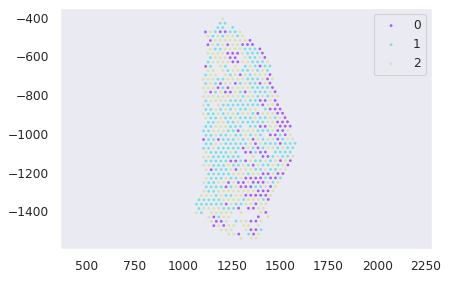

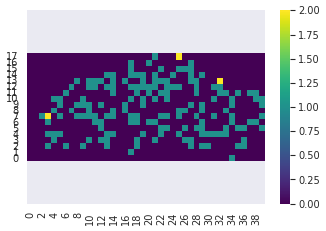

In [132]:
print(counts)
counts.uns['het']
plt.ion()
het_plot(data_subset, use_cluster='louvain', het=counts.uns['het'], dpi=80, name='het_louvain', output='.')
plt.show()

In [128]:
type(counts.uns['het'])

pandas.core.frame.DataFrame

In [71]:
counts.uns['het'].min(axis=0).min()

0